In [715]:
import matplotlib.pyplot as plt
import seaborn as sns
import math
import random
import numpy as np
import pandas as pd
import requests
from bs4 import BeautifulSoup
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from statsmodels.nonparametric.smoothers_lowess import lowess
from datetime import datetime, timedelta

In [716]:
pd.set_option('display.max_columns', None)

In [ ]:
sns.set_style()

In [717]:
# link = 'http://www.tennisabstract.com/cgi-bin/leaders.cgi?f=s00t1/'

# Primary Scraping

In [718]:
# Stats dataset
other = pd.read_html("other.html")[0]
other = other[["Rk", "Player", "TPW%", "S W%", "G W%"]]

serving = pd.read_html("serve.html")[0]
serving = serving[["Player", '1stIn', '1st%', '2nd%', '2%-InP', 'Hld%']]

returning = pd.read_html("return.html")[0]
returning = returning[["Player", "RPW", "v1st%", "v2nd%", "Brk%"]]

breaking = pd.read_html("break.html")[0]
breaking = breaking[["Player", "BPConv%","BPSvd%"]]

stats = pd.merge(other, serving, on="Player")
stats = pd.merge(stats, returning, on="Player")
stats = pd.merge(stats, breaking, on="Player")

stats["Player"] = stats["Player"].apply(lambda p: p.split(" [")[0])

stat_cols = ['TPW%', 'S W%', 'G W%', '1stIn', '1st%', '2nd%',
       '2%-InP', 'Hld%', 'RPW', 'v1st%', 'v2nd%', 'Brk%', 'BPConv%', 'BPSvd%']

In [ ]:
key_columns = ["tourney_name", "tourney_level","surface",'winner_name', 'winner_hand', 'winner_age','loser_name', 'loser_hand','loser_age','winner_rank', 'loser_rank']
surface_key = {"Hard": 0, "Clay": 1, "Grass": 2}
level_key = {"A": 0, "D": 1, "M": 2, "F":3,"G":4}
hand_key = {"R": 0, "L": 1, "U":2}

In [719]:
def surface_to_num(s):
    return surface_key[s]

def level_to_num(l):
    return level_key[l]

def hand_to_num(h):
    if type(h) == float:
        return 2
    else:
        return hand_key[h]

def flip_players(match_df):

    for i in range(len(match_df)):
        if (random.randint(0,1)) == 0:
#             print("--")
#             print("Match:"+str(i))

            # switch players around

            for col in match_df.columns:
                if "Player A " in col:
                    categ = col.split("Player A ")[1]
                    b_col = "Player B " + categ

                    a_info = match_df[col].iloc[i]
                    b_info = match_df[b_col].iloc[i]

#                     print(col,a_info)
#                     print(b_col,b_info)

                    match_df[col].iloc[i] = b_info
                    match_df[b_col].iloc[i] = a_info

            match_df["Outcome"].iloc[i] = 0
    print("Randomized order")

# New Stats, Match by Match

In [720]:
matches_2022 = pd.read_csv("https://raw.githubusercontent.com/JeffSackmann/tennis_atp/master/atp_matches_2022.csv")
matches_2023 = pd.read_csv("https://raw.githubusercontent.com/JeffSackmann/tennis_atp/master/atp_matches_2023.csv")

all_matches = pd.concat([matches_2022, matches_2023], axis = 0).reset_index(drop=True)

In [721]:
# Gets a player's list of matches
def get_player_matches(all_matches,player):
    matches_won = all_matches[all_matches['winner_name'] == player]    
    matches_lost = all_matches[all_matches['loser_name'] == player]

    return pd.concat([matches_won, matches_lost]).sort_values(by = "tourney_date").reset_index(drop=True)

# Gets a player's list of matches after a certain date (the last 'span' days)
def get_recent_matches(matches,span):
    cutoff = int((datetime.now()-timedelta(span)).strftime("%Y%m%d"))
    
    return matches[matches['tourney_date']>cutoff]

In [822]:
# Get's a player's ranking from last match played 
def get_player_ranking(last_match, player):

    if last_match["winner_name"] == player:
        return last_match["winner_rank"]
    else:
        return last_match["loser_rank"]

# Gets the split of sets, games, and breakes given a scoreline
def calc_set_game_tallies(scoreline):

    # By default, assumes neither set nor game info exists
    win_tallies = {'set':float("NaN"), 'game':float("NaN"), 'tb':{'w_tbs_won':0, 'l_tbs_won':0}}
    
    # Checks if the scoreline is Null
    if (type(scoreline)==float):
        return win_tallies
    # Valid score
    else:
        # Dicts to hold the total # of sets and games and the split between the loser and winner
        player_sets = {'tot_sets': 0, 'w_sets': 0, 'l_sets': 0}
        player_games = {'tot_games': 0, 'w_games': 0, 'l_games':0}
        sets = scoreline.split()

        # Iterates through sets and increments above values
        for set in sets:
            game_split = set.split('[')[0].split('(')[0].split('-')

            # If the set doesn't end in a default
            if len(game_split) == 2:
                
                # Games
                player_games['w_games'] += int(game_split[0])
                player_games['l_games'] += int(game_split[1])

                # Sets
                player_sets['tot_sets'] += 1
                if int(game_split[0]) > int(game_split[1]):
                    player_sets['w_sets'] += 1
                else:
                    player_sets['l_sets'] += 1

                # Tiebreakers
                if int(game_split[0]) == 7 and int(game_split[1]) == 6:
                    win_tallies["tb"]['w_tbs_won'] += 1
                elif int(game_split[1]) == 7 and int(game_split[0]) == 6:
                    win_tallies["tb"]['l_tbs_won'] += 1
                
        player_games['tot_games'] = player_games['w_games'] + player_games['l_games']

        # Final pcts        
        if player_games['tot_games'] != 0:
            win_tallies['set'] = player_sets
            win_tallies['game'] = player_games

        return win_tallies

# Calculates serving metrics for a match, given that it's a win or loss for the player at hand
def calc_serve_metrics(match_info, w_or_l):
    
    serve_metrics = {'1st_in_pct':float("NaN"),
                    '2nd_in_pct':float("NaN"),
                    '1st_won_pct':float("NaN"),
                    '2nd_won_pct':float("NaN")}

    # Calculating each of the service-related metrics, ensuring that each of the used features aren't null
    if w_or_l == 'w':
        if not np.isnan(match_info['w_svpt']) and match_info['w_svpt'] > 0:
            if not np.isnan(match_info['w_1stIn']):
                # Number of second serves hit
                num_2nd = match_info['w_svpt']-match_info['w_1stIn']
                serve_metrics['1st_in_pct'] = match_info['w_1stIn']/match_info['w_svpt']

                if not np.isnan(match_info['w_df']) and num_2nd > 0:
                    serve_metrics['2nd_in_pct'] = (num_2nd-match_info['w_df'])/num_2nd

                if not np.isnan(match_info['w_1stWon']) and match_info['w_1stIn'] > 0:
                    serve_metrics['1st_won_pct'] = match_info['w_1stWon']/match_info['w_1stIn']

                if not np.isnan(match_info['w_2ndWon']) and num_2nd > 0:
                    serve_metrics['2nd_won_pct'] = match_info['w_2ndWon']/num_2nd

    else:
        if not np.isnan(match_info['l_svpt']) and match_info['l_svpt'] > 0:
            if not np.isnan(match_info['l_1stIn']):
                # Number of second serves hit
                num_2nd = match_info['l_svpt']-match_info['l_1stIn']
                serve_metrics['1st_in_pct'] = match_info['l_1stIn']/match_info['l_svpt']

                if not np.isnan(match_info['l_df']) and num_2nd > 0:
                    serve_metrics['2nd_in_pct'] = (num_2nd-match_info['l_df'])/num_2nd

                if not np.isnan(match_info['l_1stWon']) and match_info['l_1stIn'] > 0:
                    serve_metrics['1st_won_pct'] = match_info['l_1stWon']/match_info['l_1stIn']

                if not np.isnan(match_info['l_2ndWon']) and num_2nd > 0:
                    serve_metrics['2nd_won_pct'] = match_info['l_2ndWon']/num_2nd

    return serve_metrics

# Calculates breaking metrics for a match, given that it's a win or loss for the player at hand
def calc_breaking_metrics(match_info, w_or_l):

    # Break: % of opponent's service games broken; Break Saved: % of break points saved; Break Conv.: % of break points converted
    breaking_metrics = {'break':float("NaN"),
                        'break_svd':float("NaN"),
                        'break_conv':float("NaN")}

    # Calculating each of the breaking-related metrics, ensuring that each of the used features aren't null    
    if w_or_l == 'w':
        if not np.isnan(match_info['l_bpFaced']) and not np.isnan(match_info['l_bpSaved']) and not np.isnan(match_info['l_SvGms']) and match_info['l_SvGms'] > 0 and match_info['l_bpFaced'] > 0:
            breaking_metrics['break'] = (match_info['l_bpFaced']-match_info['l_bpSaved'])/match_info['l_SvGms']
            breaking_metrics['break_conv'] = (match_info['l_bpFaced']-match_info['l_bpSaved'])/match_info['l_bpFaced']
        if not np.isnan(match_info['w_bpSaved']) and not np.isnan(match_info['w_bpFaced']) and match_info['w_bpFaced'] > 0:
            breaking_metrics['break_svd'] = match_info['w_bpSaved']/match_info['w_bpFaced']
    else:
        if not np.isnan(match_info['w_bpFaced']) and not np.isnan(match_info['w_bpSaved']) and not np.isnan(match_info['w_SvGms']) and match_info['w_SvGms'] > 0 and match_info['w_bpFaced'] > 0:
            breaking_metrics['break'] = (match_info['w_bpFaced']-match_info['w_bpSaved'])/match_info['w_SvGms']
            breaking_metrics['break_conv'] = (match_info['w_bpFaced']-match_info['w_bpSaved'])/match_info['w_bpFaced']
        if not np.isnan(match_info['l_bpSaved']) and not np.isnan(match_info['l_bpFaced']) and match_info['l_bpFaced'] > 0:
            breaking_metrics['break_svd'] = match_info['l_bpSaved']/match_info['l_bpFaced']

    return breaking_metrics

# Calculates return metrics for a match, given that it's a win or loss for the player at hand
def calc_return_metrics(match_info, w_or_l):

    return_metrics = {'pts_won_v_1st':float("NaN"),
                      'pts_won_v_2nd':float("NaN")}

    # Calculating both of the return-related metrics, ensuring that each of the used features aren't null
    if w_or_l == 'w':
        if not np.isnan(match_info['l_1stIn']) and not np.isnan(match_info['l_1stWon']) and match_info['l_1stIn'] > 0:
            return_metrics['pts_won_v_1st'] = (match_info['l_1stIn']-match_info['l_1stWon'])/match_info['l_1stIn']
        if not np.isnan(match_info['l_svpt']) and not np.isnan(match_info['l_1stIn']) and not np.isnan(match_info['l_2ndWon']) and (match_info['l_svpt']-match_info['l_1stIn']) > 0:
            return_metrics['pts_won_v_2nd'] = (match_info['l_svpt']-match_info['l_1stIn']-match_info['l_2ndWon'])/(match_info['l_svpt']-match_info['l_1stIn'])
    else:
        if not np.isnan(match_info['w_1stIn']) and not np.isnan(match_info['w_1stWon']) and match_info['w_1stIn'] > 0:
            return_metrics['pts_won_v_1st'] = (match_info['w_1stIn']-match_info['w_1stWon'])/match_info['w_1stIn']
        if not np.isnan(match_info['w_svpt']) and not np.isnan(match_info['w_1stIn']) and not np.isnan(match_info['w_2ndWon']) and (match_info['w_svpt']-match_info['w_1stIn']) > 0:
            return_metrics['pts_won_v_2nd'] = (match_info['w_svpt']-match_info['w_1stIn']-match_info['w_2ndWon'])/(match_info['w_svpt']-match_info['w_1stIn'])

    return return_metrics


# Calculates tournament level performance
def calc_level_performance(player_matches,lvls,player):
    win_pcts_by_lvl = {}
    
    for lvl in lvls:
        matches_at_lvl = player_matches[player_matches["tourney_level"] == lvl]
        num_matches_at_lvl = len(matches_at_lvl)
    
        if num_matches_at_lvl > 0:
            win_pcts_by_lvl['win_pct '+lvl] = len(matches_at_lvl[matches_at_lvl['winner_name'] == player])/num_matches_at_lvl
        else:
            win_pcts_by_lvl['win_pct '+lvl] = float("NaN")

    return win_pcts_by_lvl

# Calculate the activity of the player over a certain period of time
def calculate_player_activity(player_matches,span):
    return len(player_matches)/span

# Calculates all stats for individual player and a certain match
def calc_player_stats(match_info, player):

    # List of fractional features for ensuring that metrics aren't > 1 for faulty data
    pct_stats = ['set', 'game', 'hold', '1st_in_pct', '2nd_in_pct', '1st_won_pct', '2nd_won_pct', 'break',
             'break_svd', 'break_conv', 'pts_won_v_1st', 'pts_won_v_2nd']
    

    # If the player won or lost
    w_or_l = "w"
    if match_info["winner_name"] != player:
        w_or_l = "l"        

    # Gets the split in the score for the match (for sets, games, and breakers)
    set_game_tallies = calc_set_game_tallies(match_info['score'])
    player_sets, player_games, tb_info = set_game_tallies['set'], set_game_tallies['game'], set_game_tallies['tb']

    # Calculate stats
    player_stats = {'set':float("NaN"),
                    'game':float("NaN"),
                    'hold':float("NaN")}

    # Gets opponent ranking points
    opponent_pts = match_info["loser_rank_points"]
    
    if w_or_l == "w":
        # Proportions of sets and games 
        if type(player_sets) == dict:
            player_stats['set'] = player_sets['w_sets']/player_sets['tot_sets']
        if type(player_games) == dict:
            player_stats['game'] = player_games['w_games']/player_games['tot_games']
            
            # Proportion of service games held
            if not np.isnan(match_info['l_bpFaced']) and not np.isnan(match_info['l_bpSaved']) and not np.isnan(match_info['w_SvGms']) and match_info['w_SvGms'] > 0:
                player_stats['hold'] = (player_games['w_games']-tb_info['w_tbs_won']-(match_info['l_bpFaced']-match_info['l_bpSaved']))/match_info['w_SvGms']

    else:
        # Updates ranking points
        opponent_pts = match_info["winner_rank_points"]
        
        # Proportions of sets and games won
        if type(player_sets) == dict:
            player_stats['set'] = player_sets['l_sets']/player_sets['tot_sets']
        if type(player_games) == dict:
            player_stats['game'] = player_games['l_games']/player_games['tot_games']
        
            # Proportion of service games held
            if not np.isnan(match_info['w_bpFaced']) and not np.isnan(match_info['w_bpSaved']) and not np.isnan(match_info['l_SvGms']) and match_info['l_SvGms'] > 0:
                player_stats['hold'] = (player_games['l_games']-tb_info['l_tbs_won']-(match_info['w_bpFaced']-match_info['w_bpSaved']))/match_info['l_SvGms']

    aggr_stats = {**player_stats, **calc_serve_metrics(match_info, w_or_l), **calc_breaking_metrics(match_info, w_or_l), **calc_return_metrics(match_info, w_or_l), "Oppononet Pts":opponent_pts}

    for stat in pct_stats:
        if aggr_stats[stat] > 1:
            aggr_stats[stat] = float("NaN")

    return aggr_stats

In [823]:
# For metrics across a set of matches (either entire set of matches across the year, matches across a surface, etc.)
def produce_mean_metrics(match_list,player,prefix=''): # Prefix is if it is for a surface (i.e. 'Grass ')

    lvls = all_matches['tourney_level'].unique() # Number of unique levels

    # Hardcoding the number of days to include for overall and recent data
    overall_span = 730 
    recency_span = 90

    # Calculate stat columns
    calculated_stats = ['Set W%','Game W%','Hold %','1st Serve In %','2nd Serve In %','1st Serve Won %','2nd Serve Won %',
                        'Breaking %','Break Pts Saved %','Break Pts Conv. %','Pts Won v 1st Serve %','Pts Won v 2nd Serve %','Opponent Quality']
    
    match_list[calculated_stats] = match_list.apply(lambda row: pd.Series(calc_player_stats(row, player)), axis=1)

    # Career stats
    mean_career_stats = {}
    
    # Recent stats
    recent_matches = get_recent_matches(match_list,recency_span)
    mean_recent_stats = {}

    # Gets mean info 
    for category in calculated_stats:
        mean_career_stats[category] = match_list[category].mean()
        mean_recent_stats["3mo " + category] = recent_matches[category].mean()

    # Adds activity
    mean_career_stats.update({'Activity': calculate_player_activity(match_list,overall_span)})
    mean_recent_stats.update({'3mo Activity': calculate_player_activity(recent_matches,recency_span)})

    # Calculate performance across various tournament levels
    player_lvl_performance = calc_level_performance(match_list,lvls,player)
    recent_player_lvl_performance = calc_level_performance(recent_matches,lvls,player)
    recent_player_lvl_performance = {'3mo ' + lvl: pct for lvl, pct in recent_player_lvl_performance.items()}

    # Aggregates stats together and adds the prefix 
    aggr_stats = {**mean_career_stats,**player_lvl_performance,**mean_recent_stats,**recent_player_lvl_performance}
    aggr_stats_prefix = {prefix + stat: value for stat, value in aggr_stats.items()}

    return aggr_stats_prefix

In [824]:
def get_cumulative_stats(all_matches):

    # Hardcoding the number of days to include for recent data
    recency_span = 90

    # List of unique players and dictionary to store each player's stats
    all_players = list(set(all_matches['winner_name']).union(all_matches['loser_name']))
    player_stats = {}

    # Unique tournament levels
    lvls = all_matches['tourney_level'].unique()

    # List of surfaces (hard, grass, clay, etc.)
    surfaces = list(all_matches['surface'].unique()) 
    
    # Iterate through each player
    for player in all_players:
        
        # Get all of their matches
        player_matches = get_player_matches(all_matches,player)

        # Store the stats in the dictionary
        produced_metrics = {"Last Rank":get_player_ranking(player_matches.iloc[-1], player)}
        produced_metrics.update(produce_mean_metrics(player_matches, player))

        # Iterates through surfaces and gets their surface-specific match stats
        for s in surfaces:
            surface_matches = (player_matches[player_matches['surface'] == s]).copy(deep=True)
            if len(surface_matches) > 0:
                produced_metrics.update(produce_mean_metrics(surface_matches, player, s+' ')) # +' ' necessary for space

        player_stats[player] = produced_metrics
    
    return player_stats

In [ ]:
def randomize_matches(match_data):

    # Copies original matches
    matches_copy = match_data.copy(deep=True)

    # Randomizes match order
    matches_copy['player_A'] = np.where(np.random.rand(len(matches_copy)) > 0.5, matches_copy['winner_name'], matches_copy['loser_name'])
    matches_copy['player_B'] = np.where(matches_copy['player_A'] == matches_copy['winner_name'], matches_copy['loser_name'], matches_copy['winner_name'])
    matches_copy['outcome'] = np.where(matches_copy['player_A'] == matches_copy['winner_name'], 0, 1)

    return matches_copy[['player_A', 'player_B', 'outcome']]

In [825]:
def get_matches_with_stats(match_data):

    calculated_stats = ['Last Rank', 'Set W%', 'Game W%', 'Hold %', '1st Serve In %',
       '2nd Serve In %', '1st Serve Won %', '2nd Serve Won %', 'Breaking %',
       'Break Pts Saved %', 'Break Pts Conv. %', 'Pts Won v 1st Serve %',
       'Pts Won v 2nd Serve %', 'Opponent Quality', '3mo Set W%',
       '3mo Game W%', '3mo Hold %', '3mo 1st Serve In %', '3mo 2nd Serve In %',
       '3mo 1st Serve Won %', '3mo 2nd Serve Won %', '3mo Breaking %',
       '3mo Break Pts Saved %', '3mo Break Pts Conv. %',
       '3mo Pts Won v 1st Serve %', '3mo Pts Won v 2nd Serve %',
       '3mo Opponent Quality']

    # Gets final player stats
    player_stats = get_cumulative_stats(match_data)

    # Randomizes player A and B
    r_match_data = randomize_matches(match_data)

    # Merging stats with player A
    stat_data = pd.DataFrame(player_stats).transpose().reset_index().rename(columns={"index":"player_A"})      
    matches_w_stats = pd.merge(r_match_data, stat_data, on='player_A')
    rename_dict = {}
    
    for col in calculated_stats:
        rename_dict[col] = f"player_A {col}"
        
    matches_w_stats = matches_w_stats.rename(columns=rename_dict)

    # Merging stats with player B
    stat_data = stat_data.rename(columns={"player_A":"player_B"})      
    matches_w_stats = pd.merge(matches_w_stats, stat_data, on='player_B')

    for col in calculated_stats:
        rename_dict[col] = f"player_B {col}"
        
    matches_w_stats = matches_w_stats.rename(columns=rename_dict)

    return matches_w_stats

In [826]:
st = get_cumulative_stats(all_matches)
stat_data = pd.DataFrame(st).transpose()

In [496]:
final_stats=get_cumulative_stats(all_matches)

In [545]:
stat_data = pd.DataFrame(final_stats).transpose().reset_index().rename(columns={"index":"player_A"})                                           

In [537]:
match_outcomes = randomize_matches(all_matches)

In [548]:
mg = pd.merge(match_outcomes, stat_data, on='player_A')

# Old Stuff

In [25]:
key_columns = ["tourney_name", "tourney_level","surface",'winner_name', 'winner_hand', 'winner_age','loser_name', 'loser_hand','loser_age','winner_rank', 'loser_rank']
surface_key = {"Hard": 0, "Clay": 1, "Grass": 2}
level_key = {"A": 0, "D": 1, "M": 2, "F":3,"G":4}
hand_key = {"R": 0, "L": 1, "U":2}

matches = all_matches[key_columns]
matches["surface"] = matches["surface"].apply(surface_to_num)
matches["tourney_level"] = matches["tourney_level"].apply(level_to_num)
matches["winner_hand"] = matches["winner_hand"].apply(hand_to_num)
matches["loser_hand"] = matches["loser_hand"].apply(hand_to_num)

matches.rename(columns = {"tourney_level":"Tournament Caliber", "tourney_name":"Tournament",
                          "winner_name":"Player A Name", "winner_hand":"Player A Hand", 
                          "winner_age":"Player A Age", "loser_name":"Player B Name",
                          "loser_hand":"Player B Hand", "loser_age": "Player B Age","winner_rank":"Player A Rank",
                          "loser_rank": "Player B Rank", "surface":"Surface"}, inplace=True)

# If A wins, 1 (A loses, 0)
matches["Outcome"] = 1
matches = matches[(matches["Player A Rank"]<=50) & (matches["Player B Rank"]<=50)].reset_index(drop=True)

# Flips players randomly
flip_players(matches)

NameError: name 'surface_to_num' is not defined

In [457]:
# create columns for additional stats

for col in stat_cols:
    matches["Player A " + col] = 0;
    matches["Player B " + col] = 0;

players_with_stats = stats["Player"].values
matches_without_stats = []

for i in range(len(matches)):
    
    player_a = matches["Player A Name"].iloc[i]
    player_b = matches["Player B Name"].iloc[i]
    
    if (player_a not in players_with_stats) or (player_b not in players_with_stats): 
        matches_without_stats.append(i)
    else:
        for col in stat_cols:
            matches["Player A " + col].iloc[i] = stats[stats["Player"] == player_a][col].iloc[0]
            matches["Player B " + col].iloc[i] = stats[stats["Player"] == player_b][col].iloc[0]
        
matches = matches.drop(matches_without_stats).reset_index(drop = True)

/var/folders/g5/h7pcddkx2lz1_knw8_s59vk40000gp/T/ipykernel_58857/3141320654.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  matches["Player A " + col].iloc[i] = stats[stats["Player"] == player_a][col].iloc[0]
/var/folders/g5/h7pcddkx2lz1_knw8_s59vk40000gp/T/ipykernel_58857/3141320654.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  matches["Player B " + col].iloc[i] = stats[stats["Player"] == player_b][col].iloc[0]
/var/folders/g5/h7pcddkx2lz1_knw8_s59vk40000gp/T/ipykernel_58857/3141320654.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

In [458]:
# re-encoding categoricals

matches["Hard"] = 0
matches["Clay"] = 0
matches["Grass"] = 0

matches["Player A Lefty"] = 0
matches["Player B Lefty"] = 0

for i in range(len(matches)):
    if matches["Surface"].iloc[i] == 0:
        matches["Hard"].iloc[i] = 1
    elif matches["Surface"].iloc[i] == 1:
        matches["Clay"].iloc[i] = 1
    else:
        matches["Grass"].iloc[i] = 1
        
    if matches["Player A Hand"].iloc[i] == 1:
        matches["Player A Lefty"].iloc[i] = 1
        
    if matches["Player B Hand"].iloc[i] == 1:
        matches["Player B Lefty"].iloc[i] = 1

/var/folders/g5/h7pcddkx2lz1_knw8_s59vk40000gp/T/ipykernel_58857/2427242607.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  matches["Hard"].iloc[i] = 1
/var/folders/g5/h7pcddkx2lz1_knw8_s59vk40000gp/T/ipykernel_58857/2427242607.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  matches["Hard"].iloc[i] = 1
/var/folders/g5/h7pcddkx2lz1_knw8_s59vk40000gp/T/ipykernel_58857/2427242607.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-cop

In [460]:
# Rewriting percentages
pct_cols = ['Player A TPW%', 'Player B TPW%', 'Player A S W%',
       'Player B S W%', 'Player A G W%', 'Player B G W%', 'Player A 1stIn',
       'Player B 1stIn', 'Player A 1st%', 'Player B 1st%', 'Player A 2nd%',
       'Player B 2nd%', 'Player A 2%-InP', 'Player B 2%-InP', 'Player A Hld%',
       'Player B Hld%', 'Player A RPW', 'Player B RPW', 'Player A v1st%',
       'Player B v1st%', 'Player A v2nd%', 'Player B v2nd%', 'Player A Brk%',
       'Player B Brk%', 'Player A BPConv%', 'Player B BPConv%',
       'Player A BPSvd%', 'Player B BPSvd%']

for col in pct_cols:
    matches[col] = matches[col].apply(lambda p: round(float(p.split("%")[0])/100,3))

In [461]:
# final columns

final_columns = ['Tournament Caliber', 'Hard', 'Clay', 'Grass','Player A Lefty', 'Player B Lefty','Player A Age','Player B Age',
                   'Player A Rank', 'Player B Rank', 'Player A TPW%',
                   'Player B TPW%', 'Player A S W%', 'Player B S W%', 'Player A G W%',
                   'Player B G W%', 'Player A 1stIn', 'Player B 1stIn', 'Player A 1st%',
                   'Player B 1st%', 'Player A 2nd%', 'Player B 2nd%', 'Player A 2%-InP',
                   'Player B 2%-InP', 'Player A Hld%', 'Player B Hld%', 'Player A RPW',
                   'Player B RPW', 'Player A v1st%', 'Player B v1st%', 'Player A v2nd%',
                   'Player B v2nd%', 'Player A Brk%', 'Player B Brk%', 'Player A BPConv%',
                   'Player B BPConv%', 'Player A BPSvd%', 'Player B BPSvd%', 'Outcome']

data = matches[final_columns]

In [464]:
# Labels are the values we want to predict
labels = np.array(data['Outcome'])

# Remove the labels from the features
features = data.drop('Outcome', axis = 1)

# Saving feature names for later use
feature_list = list(features.columns)

# Convert to numpy array
features = np.array(features)

In [303]:
# Using Skicit-learn to split data into training and testing sets
# Split the data into training and testing sets
train_features, test_features, train_labels, test_labels = train_test_split(features, labels, test_size = 0.25, random_state = 42)

In [304]:
# Verifying split
print('Training Features Shape:', train_features.shape)
print('Training Labels Shape:', train_labels.shape)
print('Testing Features Shape:', test_features.shape)
print('Testing Labels Shape:', test_labels.shape)

Training Features Shape: (213, 38)
Training Labels Shape: (213,)
Testing Features Shape: (72, 38)
Testing Labels Shape: (72,)


# Decision Trees

In [267]:
model = DecisionTreeClassifier(random_state = 13)
model.fit(train_features, train_labels)
predicted = model.predict(test_features)

In [268]:
from sklearn.metrics import accuracy_score
accuracy = accuracy_score(predicted, test_labels)
print(f'Accuracy: {accuracy}')

Accuracy: 0.5833333333333334


# Random Forest

## Finding optimal number of trees

In [ ]:
# honing data
imp_feats = []

honed_data = data[imp_feats]

labels = np.array(honed_data['Outcome'])

# Remove the labels from the features
features = honed_data.drop('Outcome', axis = 1)

# Saving feature names for later use
feature_list = list(features.columns)

# Convert to numpy array
features = np.array(features)

In [477]:
# Using Skicit-learn to split data into training and testing sets
# Split the data into training and testing sets
train_features, test_features, train_labels, test_labels = train_test_split(features, labels, test_size = 0.25, random_state = 42)

In [478]:
# Verifying split
print('Training Features Shape:', train_features.shape)
print('Training Labels Shape:', train_labels.shape)
print('Testing Features Shape:', test_features.shape)
print('Testing Labels Shape:', test_labels.shape)

Training Features Shape: (534, 22)
Training Labels Shape: (534,)
Testing Features Shape: (179, 22)
Testing Labels Shape: (179,)


In [479]:
distr = pd.DataFrame()
num_ests = list(range(1,4001))
accs = []

In [480]:
def test_forest(num_est):
    # Instantiate model with num_est decision trees
    rf = RandomForestRegressor(n_estimators = num_est, random_state = 42)

    # Train the model on training data
    rf.fit(train_features, train_labels);
    
    # Use the forest's predict method on the test data
    predictions = rf.predict(test_features)
    rounded_preds = []

    for p in predictions:
        rounded_p = round(p)
    #     print(p, rounded_p)
        rounded_preds.append(rounded_p)
        
    acc = accuracy_score(rounded_preds, test_labels)
    
    print("num_est: " + str(num_est) + ", acc: " + str(acc))
    
    return acc

In [481]:
for n in num_ests:
    print("--")
    accs.append(test_forest(n))

--
num_est: 1, acc: 0.5698324022346368
--
num_est: 2, acc: 0.6033519553072626
--
num_est: 3, acc: 0.6201117318435754
--
num_est: 4, acc: 0.6033519553072626
--
num_est: 5, acc: 0.6145251396648045
--
num_est: 6, acc: 0.6145251396648045
--
num_est: 7, acc: 0.6145251396648045
--
num_est: 8, acc: 0.5977653631284916
--
num_est: 9, acc: 0.6256983240223464
--
num_est: 10, acc: 0.5810055865921788
--
num_est: 11, acc: 0.5921787709497207
--
num_est: 12, acc: 0.5698324022346368
--
num_est: 13, acc: 0.6033519553072626
--
num_est: 14, acc: 0.5810055865921788
--
num_est: 15, acc: 0.6089385474860335
--
num_est: 16, acc: 0.5810055865921788
--
num_est: 17, acc: 0.5865921787709497
--
num_est: 18, acc: 0.5810055865921788
--
num_est: 19, acc: 0.6033519553072626
--
num_est: 20, acc: 0.5921787709497207
--
num_est: 21, acc: 0.6145251396648045
--
num_est: 22, acc: 0.6033519553072626
--
num_est: 23, acc: 0.6089385474860335
--
num_est: 24, acc: 0.5865921787709497
--
num_est: 25, acc: 0.5921787709497207
--
num_es

num_est: 204, acc: 0.6201117318435754
--
num_est: 205, acc: 0.6089385474860335
--
num_est: 206, acc: 0.6033519553072626
--
num_est: 207, acc: 0.6089385474860335
--
num_est: 208, acc: 0.6033519553072626
--
num_est: 209, acc: 0.6089385474860335
--
num_est: 210, acc: 0.6089385474860335
--
num_est: 211, acc: 0.6089385474860335
--
num_est: 212, acc: 0.6089385474860335
--
num_est: 213, acc: 0.6201117318435754
--
num_est: 214, acc: 0.6089385474860335
--
num_est: 215, acc: 0.6089385474860335
--
num_est: 216, acc: 0.6033519553072626
--
num_est: 217, acc: 0.6089385474860335
--
num_est: 218, acc: 0.6089385474860335
--
num_est: 219, acc: 0.6145251396648045
--
num_est: 220, acc: 0.6145251396648045
--
num_est: 221, acc: 0.6145251396648045
--
num_est: 222, acc: 0.6145251396648045
--
num_est: 223, acc: 0.6089385474860335
--
num_est: 224, acc: 0.6201117318435754
--
num_est: 225, acc: 0.6256983240223464
--
num_est: 226, acc: 0.6201117318435754
--
num_est: 227, acc: 0.6145251396648045
--
num_est: 228, ac

num_est: 404, acc: 0.5865921787709497
--
num_est: 405, acc: 0.5865921787709497
--
num_est: 406, acc: 0.5921787709497207
--
num_est: 407, acc: 0.5921787709497207
--
num_est: 408, acc: 0.5865921787709497
--
num_est: 409, acc: 0.5865921787709497
--
num_est: 410, acc: 0.5865921787709497
--
num_est: 411, acc: 0.5865921787709497
--
num_est: 412, acc: 0.5865921787709497
--
num_est: 413, acc: 0.5865921787709497
--
num_est: 414, acc: 0.5810055865921788
--
num_est: 415, acc: 0.5810055865921788
--
num_est: 416, acc: 0.5865921787709497
--
num_est: 417, acc: 0.5810055865921788
--
num_est: 418, acc: 0.5810055865921788
--
num_est: 419, acc: 0.5810055865921788
--
num_est: 420, acc: 0.5810055865921788
--
num_est: 421, acc: 0.5810055865921788
--
num_est: 422, acc: 0.5810055865921788
--
num_est: 423, acc: 0.5865921787709497
--
num_est: 424, acc: 0.5810055865921788
--
num_est: 425, acc: 0.5865921787709497
--
num_est: 426, acc: 0.5810055865921788
--
num_est: 427, acc: 0.5810055865921788
--
num_est: 428, ac

num_est: 604, acc: 0.5865921787709497
--
num_est: 605, acc: 0.5810055865921788
--
num_est: 606, acc: 0.5865921787709497
--
num_est: 607, acc: 0.5865921787709497
--
num_est: 608, acc: 0.5865921787709497
--
num_est: 609, acc: 0.5865921787709497
--
num_est: 610, acc: 0.5865921787709497
--
num_est: 611, acc: 0.5865921787709497
--
num_est: 612, acc: 0.5865921787709497
--
num_est: 613, acc: 0.5810055865921788
--
num_est: 614, acc: 0.5810055865921788
--
num_est: 615, acc: 0.5810055865921788
--
num_est: 616, acc: 0.5810055865921788
--
num_est: 617, acc: 0.5810055865921788
--
num_est: 618, acc: 0.5810055865921788
--
num_est: 619, acc: 0.5810055865921788
--
num_est: 620, acc: 0.5754189944134078
--
num_est: 621, acc: 0.5754189944134078
--
num_est: 622, acc: 0.5754189944134078
--
num_est: 623, acc: 0.5810055865921788
--
num_est: 624, acc: 0.5810055865921788
--
num_est: 625, acc: 0.5810055865921788
--
num_est: 626, acc: 0.5810055865921788
--


KeyboardInterrupt: 

In [483]:
distr["Num Trees"] = list(range(1,len(accs)+1))
distr["Accs"] = accs

<Axes: xlabel='Num Trees', ylabel='Accs'>

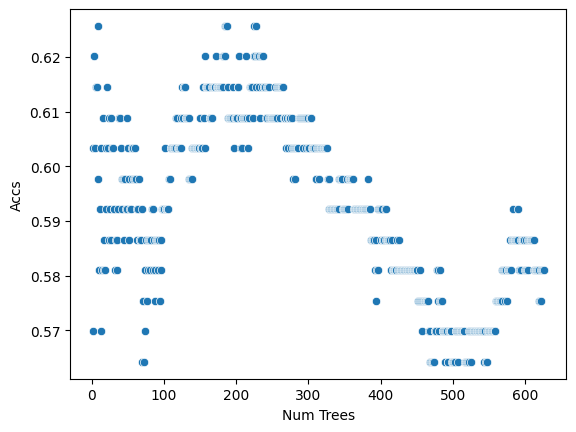

In [484]:
sns.scatterplot(distr, x="Num Trees", y = "Accs")

## Final Model

In [488]:
distr.sort_values(by = "Accs", ascending = False)

,Num Trees,Accs
224,225,0.625698
185,186,0.625698
227,228,0.625698
184,185,0.625698
8,9,0.625698
...,...,...
522,523,0.564246
520,521,0.564246
519,520,0.564246
518,519,0.564246


In [485]:
# Get optimized number of trees
opt_num_trees = int(distr.sort_values(by = "Accs", ascending = False).iloc[0]["Num Trees"])

In [ ]:
# Instantiate model with 1000 decision trees
rf = RandomForestClassifier(n_estimators = opt_num_trees, random_state = 42)

# Train the model on training data
rf.fit(train_features, train_labels);

In [419]:
# Use the forest's predict method on the test data
predictions = rf.predict(test_features)
rounded_preds = []

for p in predictions:
    rounded_p = round(p)
#     print(p, rounded_p)
    rounded_preds.append(rounded_p)

In [420]:
acc = accuracy_score(rounded_preds, test_labels)
print(f'Accuracy: {acc}')

Accuracy: 0.6805555555555556


# Retraining with imp. features

In [290]:
# Finding important features

feat_importance = pd.DataFrame()
feat_importance["Feature"] = data.columns[:-1] 
feat_importance["Importance"] = model.feature_importances_

imp_feats = list(feat_importance[feat_importance["Importance"] > 0.015]["Feature"].values)
imp_feats.append("Outcome")

In [291]:
new_data = data[imp_feats]

In [292]:
# Labels are the values we want to predict
labels = np.array(new_data['Outcome'])

# Remove the labels from the features
features = new_data.drop('Outcome', axis = 1)

# Saving feature names for later use
feature_list = list(features.columns)

# Convert to numpy array
features = np.array(features)

In [293]:
# Using Skicit-learn to split data into training and testing sets
# Split the data into training and testing sets
train_features, test_features, train_labels, test_labels = train_test_split(features, labels, test_size = 0.25, random_state = 42)

In [294]:
# Verifying split
print('Training Features Shape:', train_features.shape)
print('Training Labels Shape:', train_labels.shape)
print('Testing Features Shape:', test_features.shape)
print('Testing Labels Shape:', test_labels.shape)

Training Features Shape: (213, 22)
Training Labels Shape: (213,)
Testing Features Shape: (72, 22)
Testing Labels Shape: (72,)


In [295]:
new_model = DecisionTreeClassifier(random_state = 13)
new_model.fit(train_features, train_labels)
predicted = new_model.predict(test_features)

In [296]:
accuracy = accuracy_score(predicted, test_labels)
print(f'Accuracy: {accuracy}')

Accuracy: 0.6111111111111112


In [300]:
feat_importance.sort_values(by = "Importance", ascending = False)

,Feature,Importance
13,Player B S W%,0.199377
8,Player A Rank,0.075951
9,Player B Rank,0.074848
24,Player A Hld%,0.054600
12,Player A S W%,0.053848
6,Player A Age,0.052454
23,Player B 2%-InP,0.052311
16,Player A 1stIn,0.051375
18,Player A 1st%,0.043711
20,Player A 2nd%,0.034409


# More exploration

In [68]:
# pd.set_option('display.max_columns', None)
# import warnings
# warnings.filterwarnings('ignore')

In [3]:
# Redo match data import and preprocessing

matches_2022 = pd.read_csv("atp_matches_2022.csv")
matches_2023 = pd.read_csv("atp_matches_2023.csv")

all_matches = pd.concat([matches_2022, matches_2023], axis = 0)

In [5]:
def get_set_split(score):

    w_setsWon = 0
    l_setsWon = 0
    
    score = score.split("[")[0]
    
    for s in score.split():
        if "-" in s:
            game_split = s.split("(")[0].split("-")
            if int(game_split[0]) > int(game_split[1]):
                w_setsWon += 1
            else:
                l_setsWon += 1
    return w_setsWon, l_setsWon

def get_stats(match):
    
    ##    KEY
    #     FSin = 1stIn/svpt
    #     FSPwon = 1stWon/1stIn
    #     SSin = (svpt-1stIn-df)/(svpt-1stIn)
    #     SSPwon = 2ndWon/(svpt-1stIn-df)
    #     Hld = (SvGames-(bpFaced-bpSaved))/(SvGames)
    #     v1st = (1stIn-1stWon)/1stIn (opp stats)
    #     v2nd = (svpt-1stIn-df-2ndWon)/(svpt-1stIn-df) (opp stats)
    #     Brk = (bpFaced-bpSaved)/(SvGames) (opp stats)
    #     BPConv = (bpFaced-bpSaved)/(bpFaced) (opp stats)
    #     BPSvd = (bpSaved)/(bpFaced)
    
    playerA = {}
    playerB = {}
    
    attrs = ["S W%", "1stIn", "1st%", "2%-InP", "2nd%", "Hld%", "v1st%", "v2nd%", "Brk%", "BPConv%", "BPSvd%", "Outcome"]
    
    set_split = get_set_split(match["score"])
    total_sets = set_split[0] + set_split[1]
    
    playerA["name"] = match["winner_name"]
    playerA["S W%"] = set_split[0]/total_sets
    playerA["1stIn"] = match["w_1stIn"]/match["w_svpt"]
    playerA["1st%"] = match["w_1stWon"]/match["w_1stIn"]
    playerA["2%-InP"] = (match["w_svpt"]-match["w_1stIn"]-match["w_df"])/(match["w_svpt"]-match["w_1stIn"])
    playerA["2nd%"] = match["w_2ndWon"]/(match["w_svpt"]-match["w_1stIn"]-match["w_df"])
    playerA["Hld%"] = (match["w_SvGms"]-(match["w_bpFaced"]-match["w_bpSaved"]))/match["w_SvGms"]
    playerA["v1st%"] = (match["l_1stIn"]-match["l_1stWon"])/match["l_1stIn"]
    playerA["v2nd%"] = (match["l_svpt"]-match["l_1stIn"]-match["l_df"]-match["l_2ndWon"])/(match["l_svpt"]-match["l_1stIn"]-match["l_df"])
    playerA["Brk%"] = (match["l_bpFaced"]-match["l_bpSaved"])/match["l_SvGms"]
    playerA["BPConv%"] = (match["l_bpFaced"]-match["l_bpSaved"])/match["l_bpFaced"]
    playerA["BPSvd%"] = match["w_bpSaved"]/match["w_bpFaced"]
    playerA["Outcome"] = 1
    
    playerB["name"] = match["loser_name"]
    playerB["S W%"] = set_split[1]/total_sets
    playerB["1stIn"] = match["l_1stIn"]/match["l_svpt"]
    playerB["1st%"] = match["l_1stWon"]/match["l_1stIn"]
    playerB["2%-InP"] = (match["l_svpt"]-match["l_1stIn"]-match["l_df"])/(match["l_svpt"]-match["l_1stIn"])
    playerB["2nd%"] = match["l_2ndWon"]/(match["l_svpt"]-match["l_1stIn"]-match["l_df"])
    playerB["Hld%"] = (match["l_SvGms"]-(match["l_bpFaced"]-match["l_bpSaved"]))/match["l_SvGms"]
    playerB["v1st%"] = (match["w_1stIn"]-match["w_1stWon"])/match["w_1stIn"]
    playerB["v2nd%"] = (match["w_svpt"]-match["w_1stIn"]-match["w_df"]-match["w_2ndWon"])/(match["w_svpt"]-match["w_1stIn"]-match["w_df"])
    playerB["Brk%"] = (match["w_bpFaced"]-match["w_bpSaved"])/match["w_SvGms"]
    playerB["BPConv%"] = (match["w_bpFaced"]-match["w_bpSaved"])/match["w_bpFaced"]
    playerB["BPSvd%"] = match["l_bpSaved"]/match["l_bpFaced"]
    playerB["Outcome"] = 0
    
    for attr in attrs:
        if playerA[attr] < 0:
            playerA[attr] = float("nan")
        if playerB[attr] < 0:
            playerB[attr] = float("nan")

    return playerA, playerB

In [6]:
# Gets match by match stats

all_stats = pd.DataFrame()

for i in range(len(all_matches)):
    try:
        stat_df = pd.DataFrame(get_stats(all_matches.iloc[i]))
        stat_df["Surface"] = 0
        stat_df["Surface"] = all_matches["surface"].iloc[i]
        all_stats = pd.concat([all_stats, stat_df])
    except Exception as e:
        print(e)

/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:50: RuntimeWarning: invalid value encountered in scalar divide
  playerA["BPSvd%"] = match["w_bpSaved"]/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:63: RuntimeWarning: invalid value encountered in scalar divide
  playerB["BPConv%"] = (match["w_bpFaced"]-match["w_bpSaved"])/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:50: RuntimeWarning: invalid value encountered in scalar divide
  playerA["BPSvd%"] = match["w_bpSaved"]/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:63: RuntimeWarning: invalid value encountered in scalar divide
  playerB["BPConv%"] = (match["w_bpFaced"]-match["w_bpSaved"])/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:50: RuntimeWarning: invalid value encountered in scalar divide
  playerA["

division by zero
division by zero


/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:50: RuntimeWarning: invalid value encountered in scalar divide
  playerA["BPSvd%"] = match["w_bpSaved"]/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:63: RuntimeWarning: invalid value encountered in scalar divide
  playerB["BPConv%"] = (match["w_bpFaced"]-match["w_bpSaved"])/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:50: RuntimeWarning: invalid value encountered in scalar divide
  playerA["BPSvd%"] = match["w_bpSaved"]/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:63: RuntimeWarning: invalid value encountered in scalar divide
  playerB["BPConv%"] = (match["w_bpFaced"]-match["w_bpSaved"])/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:50: RuntimeWarning: invalid value encountered in scalar divide
  playerA["

division by zero
division by zero
division by zero
division by zero


/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:50: RuntimeWarning: invalid value encountered in scalar divide
  playerA["BPSvd%"] = match["w_bpSaved"]/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:63: RuntimeWarning: invalid value encountered in scalar divide
  playerB["BPConv%"] = (match["w_bpFaced"]-match["w_bpSaved"])/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:50: RuntimeWarning: invalid value encountered in scalar divide
  playerA["BPSvd%"] = match["w_bpSaved"]/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:63: RuntimeWarning: invalid value encountered in scalar divide
  playerB["BPConv%"] = (match["w_bpFaced"]-match["w_bpSaved"])/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:50: RuntimeWarning: invalid value encountered in scalar divide
  playerA["

division by zero
division by zero
division by zero
division by zero


/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:43: RuntimeWarning: divide by zero encountered in scalar divide
  playerA["2%-InP"] = (match["w_svpt"]-match["w_1stIn"]-match["w_df"])/(match["w_svpt"]-match["w_1stIn"])
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:57: RuntimeWarning: divide by zero encountered in scalar divide
  playerB["2%-InP"] = (match["l_svpt"]-match["l_1stIn"]-match["l_df"])/(match["l_svpt"]-match["l_1stIn"])
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:50: RuntimeWarning: invalid value encountered in scalar divide
  playerA["BPSvd%"] = match["w_bpSaved"]/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:63: RuntimeWarning: invalid value encountered in scalar divide
  playerB["BPConv%"] = (match["w_bpFaced"]-match["w_bpSaved"])/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:50

division by zero
division by zero
division by zero


/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:50: RuntimeWarning: invalid value encountered in scalar divide
  playerA["BPSvd%"] = match["w_bpSaved"]/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:63: RuntimeWarning: invalid value encountered in scalar divide
  playerB["BPConv%"] = (match["w_bpFaced"]-match["w_bpSaved"])/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:50: RuntimeWarning: invalid value encountered in scalar divide
  playerA["BPSvd%"] = match["w_bpSaved"]/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:63: RuntimeWarning: invalid value encountered in scalar divide
  playerB["BPConv%"] = (match["w_bpFaced"]-match["w_bpSaved"])/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:50: RuntimeWarning: invalid value encountered in scalar divide
  playerA["

division by zero
division by zero
division by zero
division by zero


/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:50: RuntimeWarning: invalid value encountered in scalar divide
  playerA["BPSvd%"] = match["w_bpSaved"]/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:63: RuntimeWarning: invalid value encountered in scalar divide
  playerB["BPConv%"] = (match["w_bpFaced"]-match["w_bpSaved"])/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:50: RuntimeWarning: invalid value encountered in scalar divide
  playerA["BPSvd%"] = match["w_bpSaved"]/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:63: RuntimeWarning: invalid value encountered in scalar divide
  playerB["BPConv%"] = (match["w_bpFaced"]-match["w_bpSaved"])/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:50: RuntimeWarning: invalid value encountered in scalar divide
  playerA["

division by zero
division by zero
division by zero


/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:50: RuntimeWarning: invalid value encountered in scalar divide
  playerA["BPSvd%"] = match["w_bpSaved"]/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:63: RuntimeWarning: invalid value encountered in scalar divide
  playerB["BPConv%"] = (match["w_bpFaced"]-match["w_bpSaved"])/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:50: RuntimeWarning: invalid value encountered in scalar divide
  playerA["BPSvd%"] = match["w_bpSaved"]/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:63: RuntimeWarning: invalid value encountered in scalar divide
  playerB["BPConv%"] = (match["w_bpFaced"]-match["w_bpSaved"])/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:50: RuntimeWarning: invalid value encountered in scalar divide
  playerA["

division by zero
division by zero
division by zero
division by zero


/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:50: RuntimeWarning: invalid value encountered in scalar divide
  playerA["BPSvd%"] = match["w_bpSaved"]/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:63: RuntimeWarning: invalid value encountered in scalar divide
  playerB["BPConv%"] = (match["w_bpFaced"]-match["w_bpSaved"])/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:50: RuntimeWarning: invalid value encountered in scalar divide
  playerA["BPSvd%"] = match["w_bpSaved"]/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:63: RuntimeWarning: invalid value encountered in scalar divide
  playerB["BPConv%"] = (match["w_bpFaced"]-match["w_bpSaved"])/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:50: RuntimeWarning: invalid value encountered in scalar divide
  playerA["

division by zero
division by zero
division by zero
division by zero
division by zero


/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:50: RuntimeWarning: invalid value encountered in scalar divide
  playerA["BPSvd%"] = match["w_bpSaved"]/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:63: RuntimeWarning: invalid value encountered in scalar divide
  playerB["BPConv%"] = (match["w_bpFaced"]-match["w_bpSaved"])/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:50: RuntimeWarning: invalid value encountered in scalar divide
  playerA["BPSvd%"] = match["w_bpSaved"]/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:63: RuntimeWarning: invalid value encountered in scalar divide
  playerB["BPConv%"] = (match["w_bpFaced"]-match["w_bpSaved"])/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:50: RuntimeWarning: invalid value encountered in scalar divide
  playerA["

division by zero


/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:50: RuntimeWarning: invalid value encountered in scalar divide
  playerA["BPSvd%"] = match["w_bpSaved"]/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:63: RuntimeWarning: invalid value encountered in scalar divide
  playerB["BPConv%"] = (match["w_bpFaced"]-match["w_bpSaved"])/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:50: RuntimeWarning: invalid value encountered in scalar divide
  playerA["BPSvd%"] = match["w_bpSaved"]/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:63: RuntimeWarning: invalid value encountered in scalar divide
  playerB["BPConv%"] = (match["w_bpFaced"]-match["w_bpSaved"])/match["w_bpFaced"]
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/3270608747.py:50: RuntimeWarning: invalid value encountered in scalar divide
  playerA["

In [8]:
# Dedup and mean calculation

cleaned_stats = pd.DataFrame()

for p in all_stats["name"].unique():
    p_data = all_stats[all_stats["name"] == p]

    surfaces = ["Hard", "Clay", "Grass"]

    by_surface_player_data = pd.DataFrame()
    by_surface_player_data["Name"] = [p]

    for s in surfaces:
        data = p_data[p_data["Surface"] == s]
        means = pd.DataFrame(data[['S W%', '1stIn', '1st%', '2%-InP', '2nd%', 'Hld%', 'v1st%',
       'v2nd%', 'Brk%', 'BPConv%', 'BPSvd%']].mean()).transpose()

        for col in means.columns:
            means = means.rename(columns = {col: "{} {}".format(s, col)})

        wins = data["Outcome"].sum()
        matches_played = len(data)
        win_pct = 0
        
        if (matches_played != 0):
            win_pct = wins/matches_played
        
        player_data = pd.DataFrame()
        player_data["Name"] = [p]
        player_data = pd.concat([player_data,means], axis = 1)
        player_data[s + " Matches"] = [matches_played]
        player_data[s + " Win%"] = [win_pct]

        by_surface_player_data = pd.merge(by_surface_player_data, player_data, on = "Name")
        
    overall_means = pd.DataFrame(p_data[['S W%', '1stIn', '1st%', '2%-InP', '2nd%', 'Hld%', 'v1st%',
       'v2nd%', 'Brk%', 'BPConv%', 'BPSvd%']].mean()).transpose()
    
    overall_wins = p_data["Outcome"].sum()
    overall_matches_played = len(p_data)
    overall_win_pct = 0
    
    if (matches_played != 0):
        overall_win_pct = overall_wins/overall_matches_played
    
    by_surface_player_data = pd.concat([by_surface_player_data,overall_means], axis = 1)
    by_surface_player_data["Overall Matches"] = [overall_matches_played]
    by_surface_player_data["Overall Win%"] = [overall_win_pct]

    cleaned_stats = pd.concat([cleaned_stats, by_surface_player_data])

cleaned_stats.reset_index(drop = True, inplace=True)

In [9]:
cleaned_stats

,Name,Hard S W%,Hard 1stIn,Hard 1st%,Hard 2%-InP,Hard 2nd%,Hard Hld%,Hard v1st%,Hard v2nd%,Hard Brk%,...,2%-InP,2nd%,Hld%,v1st%,v2nd%,Brk%,BPConv%,BPSvd%,Overall Matches,Overall Win%
0,Felix Auger Aliassime,0.667917,0.628994,0.792919,0.877003,0.579585,0.865229,0.299600,0.426970,0.213184,...,0.874728,0.578047,0.854271,0.306811,0.427929,0.222559,0.397257,0.626215,110,0.663636
1,Roberto Bautista Agut,0.580409,0.659132,0.715511,0.934333,0.587693,0.811102,0.294657,0.487331,0.258877,...,0.937760,0.591196,0.819883,0.305272,0.495718,0.274382,0.409964,0.585654,89,0.606742
2,Denis Shapovalov,0.567778,0.604915,0.777778,0.808219,0.648496,0.842714,0.283727,0.439273,0.217554,...,0.814171,0.649659,0.833244,0.277931,0.424368,0.190006,0.399734,0.591657,82,0.536585
3,Pablo Carreno Busta,0.635772,0.659319,0.734377,0.939910,0.626297,0.869677,0.286766,0.502624,0.260714,...,0.936070,0.627786,0.835106,0.295169,0.479571,0.259631,0.427522,0.616853,66,0.575758
4,Hubert Hurkacz,0.607407,0.653561,0.796671,0.939874,0.576079,0.908168,0.265723,0.427391,0.177436,...,0.939940,0.578957,0.899162,0.266254,0.419532,0.173726,0.380434,0.656836,98,0.642857
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
495,Chris Rodesch,1.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0.000000
496,Kris Van Wyk,0.166667,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2,0.000000
497,Raphael Calzi,1.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0.000000
498,Devin Badenhorst,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0.000000


## Combining outcome data with stats

In [12]:
key_columns = ["tourney_name", "tourney_level","surface",'winner_name', 'winner_hand', 'winner_age','loser_name', 'loser_hand','loser_age','winner_rank', 'loser_rank']
surface_key = {"Hard": 0, "Clay": 1, "Grass": 2}
level_key = {"A": 0, "D": 1, "M": 2, "F":3,"G":4}
hand_key = {"R": 0, "L": 1, "U":2}

matches = all_matches[key_columns]
matches["surface"] = matches["surface"].apply(surface_to_num)
matches["tourney_level"] = matches["tourney_level"].apply(level_to_num)
matches["winner_hand"] = matches["winner_hand"].apply(hand_to_num)
matches["loser_hand"] = matches["loser_hand"].apply(hand_to_num)

matches.rename(columns = {"tourney_level":"Tournament Caliber", "tourney_name":"Tournament",
                          "winner_name":"Player A Name", "winner_hand":"Player A Hand", 
                          "winner_age":"Player A Age", "loser_name":"Player B Name",
                          "loser_hand":"Player B Hand", "loser_age": "Player B Age","winner_rank":"Player A Rank",
                          "loser_rank": "Player B Rank", "surface":"Surface"}, inplace=True)

# If A wins, 1 (A loses, 0)
matches["Outcome"] = 1

# Flips players randomly
flip_players(matches)

/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/909553341.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  matches["surface"] = matches["surface"].apply(surface_to_num)
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/909553341.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  matches["tourney_level"] = matches["tourney_level"].apply(level_to_num)
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/909553341.py:9: SettingWithCopyWarning: 
A value is trying to 

Randomized order


IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [13]:
stat_labels = ['Hard S W%', 'Hard 1stIn', 'Hard 1st%', 'Hard 2%-InP',
       'Hard 2nd%', 'Hard Hld%', 'Hard v1st%', 'Hard v2nd%', 'Hard Brk%',
       'Hard BPConv%', 'Hard BPSvd%', 'Hard Matches', 'Hard Win%', 'Clay S W%',
       'Clay 1stIn', 'Clay 1st%', 'Clay 2%-InP', 'Clay 2nd%', 'Clay Hld%',
       'Clay v1st%', 'Clay v2nd%', 'Clay Brk%', 'Clay BPConv%', 'Clay BPSvd%',
       'Clay Matches', 'Clay Win%', 'Grass S W%', 'Grass 1stIn', 'Grass 1st%',
       'Grass 2%-InP', 'Grass 2nd%', 'Grass Hld%', 'Grass v1st%',
       'Grass v2nd%', 'Grass Brk%', 'Grass BPConv%', 'Grass BPSvd%',
       'Grass Matches', 'Grass Win%', 'S W%', '1stIn', '1st%', '2%-InP',
       '2nd%', 'Hld%', 'v1st%', 'v2nd%', 'Brk%', 'BPConv%', 'BPSvd%',
       'Overall Matches', 'Overall Win%']

In [14]:
df = matches.copy(deep = True)

In [15]:
# create columns for additional stats

for stat in stat_labels:
    df["Player A " + stat] = 0
    df["Player B " + stat] = 0
    
players_with_stats = cleaned_stats["Name"].values
matches_without_stats = []

for i in range(len(df)):
    
    player_a = df["Player A Name"].iloc[i]
    player_b = df["Player B Name"].iloc[i]
    
    if (player_a not in players_with_stats) or (player_b not in players_with_stats): 
        matches_without_stats.append(i)
    else:
        for stat in stat_labels:
            df["Player A " + stat].iloc[i] = cleaned_stats[cleaned_stats["Name"] == player_a][stat].iloc[0]
            df["Player B " + stat].iloc[i] = cleaned_stats[cleaned_stats["Name"] == player_b][stat].iloc[0]
        
data_w_stats = df.drop(matches_without_stats).reset_index(drop = True)

/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/1418811172.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df["Player B " + stat] = 0
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/1418811172.py:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df["Player A " + stat] = 0
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/1418811172.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.

/var/folders/g5/h7pcddkx2lz1_knw8_s59vk40000gp/T/ipykernel_63549/1418811172.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["Player B " + stat].iloc[i] = cleaned_stats[cleaned_stats["Name"] == player_b][stat].iloc[0]
/var/folders/g5/h7pcddkx2lz1_knw8_s59vk40000gp/T/ipykernel_63549/1418811172.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["Player A " + stat].iloc[i] = cleaned_stats[cleaned_stats["Name"] == player_a][stat].iloc[0]
/var/folders/g5/h7pcddkx2lz1_knw8_s59vk40000gp/T/ipykernel_63549/1418811172.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

S

/var/folders/g5/h7pcddkx2lz1_knw8_s59vk40000gp/T/ipykernel_63549/1418811172.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["Player A " + stat].iloc[i] = cleaned_stats[cleaned_stats["Name"] == player_a][stat].iloc[0]
/var/folders/g5/h7pcddkx2lz1_knw8_s59vk40000gp/T/ipykernel_63549/1418811172.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["Player B " + stat].iloc[i] = cleaned_stats[cleaned_stats["Name"] == player_b][stat].iloc[0]
/var/folders/g5/h7pcddkx2lz1_knw8_s59vk40000gp/T/ipykernel_63549/1418811172.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

S

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

/var/folders/g5/h7pcddkx2lz1_knw8_s59vk40000gp/T/ipykernel_63549/1418811172.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["Player A " + stat].iloc[i] = cleaned_stats[cleaned_stats["Name"] == player_a][stat].iloc[0]
/var/folders/g5/h7pcddkx2lz1_knw8_s59vk40000gp/T/ipykernel_63549/1418811172.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/us

/var/folders/g5/h7pcddkx2lz1_knw8_s59vk40000gp/T/ipykernel_63549/1418811172.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["Player A " + stat].iloc[i] = cleaned_stats[cleaned_stats["Name"] == player_a][stat].iloc[0]
/var/folders/g5/h7pcddkx2lz1_knw8_s59vk40000gp/T/ipykernel_63549/1418811172.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["Player B " + stat].iloc[i] = cleaned_stats[cleaned_stats["Name"] == player_b][stat].iloc[0]
/var/folders/g5/h7pcddkx2lz1_knw8_s59vk40000gp/T/ipykernel_63549/1418811172.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

S

/var/folders/g5/h7pcddkx2lz1_knw8_s59vk40000gp/T/ipykernel_63549/1418811172.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["Player A " + stat].iloc[i] = cleaned_stats[cleaned_stats["Name"] == player_a][stat].iloc[0]
/var/folders/g5/h7pcddkx2lz1_knw8_s59vk40000gp/T/ipykernel_63549/1418811172.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["Player B " + stat].iloc[i] = cleaned_stats[cleaned_stats["Name"] == player_b][stat].iloc[0]
/var/folders/g5/h7pcddkx2lz1_knw8_s59vk40000gp/T/ipykernel_63549/1418811172.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

S

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [16]:
# re-encoding categoricals

data_w_stats["Hard"] = 0
data_w_stats["Clay"] = 0
data_w_stats["Grass"] = 0

data_w_stats["Player A Lefty"] = 0
data_w_stats["Player B Lefty"] = 0

for i in range(len(data_w_stats)):
    if data_w_stats["Surface"].iloc[i] == 0:
        data_w_stats["Hard"].iloc[i] = 1
    elif data_w_stats["Surface"].iloc[i] == 1:
        data_w_stats["Clay"].iloc[i] = 1
    else:
        data_w_stats["Grass"].iloc[i] = 1
        
    if data_w_stats["Player A Hand"].iloc[i] == 1:
        data_w_stats["Player A Lefty"].iloc[i] = 1
        
    if data_w_stats["Player B Hand"].iloc[i] == 1:
        data_w_stats["Player B Lefty"].iloc[i] = 1

/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/2558632807.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_w_stats["Hard"].iloc[i] = 1
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/2558632807.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_w_stats["Hard"].iloc[i] = 1
/var/folders/3j/d6d8tn6919q90yph40hqnh4c0000gn/T/ipykernel_3893/2558632807.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versu

In [17]:
# Rounding for percentages

cols_to_round = ['Player A Hard S W%', 'Player B Hard S W%', 'Player A Hard 1stIn',
       'Player B Hard 1stIn', 'Player A Hard 1st%', 'Player B Hard 1st%',
       'Player A Hard 2%-InP', 'Player B Hard 2%-InP',
       'Player A Hard 2nd%', 'Player B Hard 2nd%', 'Player A Hard Hld%',
       'Player B Hard Hld%', 'Player A Hard v1st%', 'Player B Hard v1st%',
       'Player A Hard v2nd%', 'Player B Hard v2nd%', 'Player A Hard Brk%',
       'Player B Hard Brk%', 'Player A Hard BPConv%',
       'Player B Hard BPConv%', 'Player A Hard BPSvd%',
       'Player B Hard BPSvd%', 'Player A Hard Win%',
       'Player B Hard Win%', 'Player A Clay S W%', 'Player B Clay S W%',
       'Player A Clay 1stIn', 'Player B Clay 1stIn', 'Player A Clay 1st%',
       'Player B Clay 1st%', 'Player A Clay 2%-InP',
       'Player B Clay 2%-InP', 'Player A Clay 2nd%', 'Player B Clay 2nd%',
       'Player A Clay Hld%', 'Player B Clay Hld%', 'Player A Clay v1st%',
       'Player B Clay v1st%', 'Player A Clay v2nd%',
       'Player B Clay v2nd%', 'Player A Clay Brk%', 'Player B Clay Brk%',
       'Player A Clay BPConv%', 'Player B Clay BPConv%',
       'Player A Clay BPSvd%', 'Player B Clay BPSvd%',
       'Player A Clay Win%', 'Player B Clay Win%', 'Player A Grass S W%',
       'Player B Grass S W%', 'Player A Grass 1stIn',
       'Player B Grass 1stIn', 'Player A Grass 1st%',
       'Player B Grass 1st%', 'Player A Grass 2%-InP',
       'Player B Grass 2%-InP', 'Player A Grass 2nd%',
       'Player B Grass 2nd%', 'Player A Grass Hld%',
       'Player B Grass Hld%', 'Player A Grass v1st%',
       'Player B Grass v1st%', 'Player A Grass v2nd%',
       'Player B Grass v2nd%', 'Player A Grass Brk%',
       'Player B Grass Brk%', 'Player A Grass BPConv%',
       'Player B Grass BPConv%', 'Player A Grass BPSvd%',
       'Player B Grass BPSvd%', 'Player A Grass Win%',
       'Player B Grass Win%', 'Player A S W%', 'Player B S W%',
       'Player A 1stIn', 'Player B 1stIn', 'Player A 1st%',
       'Player B 1st%', 'Player A 2%-InP', 'Player B 2%-InP',
       'Player A 2nd%', 'Player B 2nd%', 'Player A Hld%', 'Player B Hld%',
       'Player A v1st%', 'Player B v1st%', 'Player A v2nd%',
       'Player B v2nd%', 'Player A Brk%', 'Player B Brk%',
       'Player A BPConv%', 'Player B BPConv%', 'Player A BPSvd%',
       'Player B BPSvd%', 'Player A Overall Win%',
       'Player B Overall Win%']

for col in cols_to_round:
    data_w_stats[col] = data_w_stats[col].apply(lambda p: round(p,3))

In [18]:
# final columns

final_columns = ['Tournament Caliber', 'Hard', 'Clay', 'Grass','Player A Lefty', 'Player B Lefty','Player A Age','Player B Age',
                   'Player A Rank', 'Player B Rank', 'Player A Hard S W%', 'Player B Hard S W%', 'Player A Hard 1stIn',
                   'Player B Hard 1stIn', 'Player A Hard 1st%', 'Player B Hard 1st%',
                   'Player A Hard 2%-InP', 'Player B Hard 2%-InP',
                   'Player A Hard 2nd%', 'Player B Hard 2nd%', 'Player A Hard Hld%',
                   'Player B Hard Hld%', 'Player A Hard v1st%', 'Player B Hard v1st%',
                   'Player A Hard v2nd%', 'Player B Hard v2nd%', 'Player A Hard Brk%',
                   'Player B Hard Brk%', 'Player A Hard BPConv%',
                   'Player B Hard BPConv%', 'Player A Hard BPSvd%',
                   'Player B Hard BPSvd%', 'Player A Hard Matches',
                   'Player B Hard Matches', 'Player A Hard Win%',
                   'Player B Hard Win%', 'Player A Clay S W%', 'Player B Clay S W%',
                   'Player A Clay 1stIn', 'Player B Clay 1stIn', 'Player A Clay 1st%',
                   'Player B Clay 1st%', 'Player A Clay 2%-InP',
                   'Player B Clay 2%-InP', 'Player A Clay 2nd%', 'Player B Clay 2nd%',
                   'Player A Clay Hld%', 'Player B Clay Hld%', 'Player A Clay v1st%',
                   'Player B Clay v1st%', 'Player A Clay v2nd%',
                   'Player B Clay v2nd%', 'Player A Clay Brk%', 'Player B Clay Brk%',
                   'Player A Clay BPConv%', 'Player B Clay BPConv%',
                   'Player A Clay BPSvd%', 'Player B Clay BPSvd%',
                   'Player A Clay Matches', 'Player B Clay Matches',
                   'Player A Clay Win%', 'Player B Clay Win%', 'Player A Grass S W%',
                   'Player B Grass S W%', 'Player A Grass 1stIn',
                   'Player B Grass 1stIn', 'Player A Grass 1st%',
                   'Player B Grass 1st%', 'Player A Grass 2%-InP',
                   'Player B Grass 2%-InP', 'Player A Grass 2nd%',
                   'Player B Grass 2nd%', 'Player A Grass Hld%',
                   'Player B Grass Hld%', 'Player A Grass v1st%',
                   'Player B Grass v1st%', 'Player A Grass v2nd%',
                   'Player B Grass v2nd%', 'Player A Grass Brk%',
                   'Player B Grass Brk%', 'Player A Grass BPConv%',
                   'Player B Grass BPConv%', 'Player A Grass BPSvd%',
                   'Player B Grass BPSvd%', 'Player A Grass Matches',
                   'Player B Grass Matches', 'Player A Grass Win%',
                   'Player B Grass Win%', 'Player A S W%', 'Player B S W%',
                   'Player A 1stIn', 'Player B 1stIn', 'Player A 1st%',
                   'Player B 1st%', 'Player A 2%-InP', 'Player B 2%-InP',
                   'Player A 2nd%', 'Player B 2nd%', 'Player A Hld%', 'Player B Hld%',
                   'Player A v1st%', 'Player B v1st%', 'Player A v2nd%',
                   'Player B v2nd%', 'Player A Brk%', 'Player B Brk%',
                   'Player A BPConv%', 'Player B BPConv%', 'Player A BPSvd%',
                   'Player B BPSvd%', 'Player A Overall Matches',
                   'Player B Overall Matches', 'Player A Overall Win%',
                   'Player B Overall Win%','Outcome']

data = data_w_stats[final_columns]

In [20]:
# data.to_csv("data_w_stats.csv")

## Re-applying ML

### Training

In [33]:
# converting data

labels = np.array(data['Outcome'])

# Remove the labels from the features
features = data.drop('Outcome', axis = 1)

# Saving feature names for later use
feature_list = list(features.columns)

# Convert to numpy array
features = np.array(features)

In [34]:
# Using Skicit-learn to split data into training and testing sets
# Split the data into training and testing sets

train_features, test_features, train_labels, test_labels = train_test_split(features, labels, test_size = 0.25, random_state = 42)

In [35]:
# Verifying split and viewing shape

print('Training Features Shape:', train_features.shape)
print('Training Labels Shape:', train_labels.shape)
print('Testing Features Shape:', test_features.shape)
print('Testing Labels Shape:', test_labels.shape)

Training Features Shape: (3456, 114)
Training Labels Shape: (3456,)
Testing Features Shape: (1152, 114)
Testing Labels Shape: (1152,)


### Decision Tree

In [40]:
model = DecisionTreeClassifier(random_state = 13)
model.fit(train_features, train_labels)
predicted = model.predict(test_features)

In [41]:
from sklearn.metrics import accuracy_score
accuracy = accuracy_score(predicted, test_labels)
print(f'Accuracy: {accuracy}')

Accuracy: 0.5850694444444444


### Random Forest

In [45]:
proc_data = data.dropna()

In [50]:
# honing data

labels = np.array(proc_data['Outcome'])

# Remove the labels from the features
features = proc_data.drop('Outcome', axis = 1)

# Saving feature names for later use
feature_list = list(features.columns)

# Convert to numpy array
features = np.array(features)

# Using Skicit-learn to split data into training and testing sets
# Split the data into training and testing sets

train_features, test_features, train_labels, test_labels = train_test_split(features, labels, test_size = 0.25, random_state = 42)

# Verifying split and viewing shape

print('Training Features Shape:', train_features.shape)
print('Training Labels Shape:', train_labels.shape)
print('Testing Features Shape:', test_features.shape)
print('Testing Labels Shape:', test_labels.shape)

Training Features Shape: (2700, 114)
Training Labels Shape: (2700,)
Testing Features Shape: (900, 114)
Testing Labels Shape: (900,)


In [82]:
rf = RandomForestClassifier(n_estimators = 95)

# Train the model on training data
rf.fit(train_features, train_labels);

# Use the forest's predict method on the test data
predictions = rf.predict(test_features)
rounded_preds = []

# for p in predictions:
#     rounded_p = round(p)
#     rounded_preds.append(rounded_p)

acc = accuracy_score(predictions, test_labels)

In [84]:
acc

0.6377777777777778

### Testing accuracy

In [57]:
distr = pd.DataFrame()
num_ests = list(range(1,1000))
accs = []

In [1003]:
def test_forest(num_est):
    # Instantiate model with num_est decision trees
    rf = RandomForestClassifier(n_estimators = num_est, random_state = 42)

    # Train the model on training data
    rf.fit(train_features, train_labels);
    
    # Use the forest's predict method on the test data
    predictions = rf.predict(test_features)
    rounded_preds = []

    for p in predictions:
        rounded_p = round(p)
    #     print(p, rounded_p)
        rounded_preds.append(rounded_p)
        
    acc = accuracy_score(rounded_preds, test_labels)
    
    print("num_est: " + str(num_est) + ", acc: " + str(acc))
    
    return acc

In [1004]:
for n in num_ests:
    print("--")
    accs.append(test_forest(n))
    


--
num_est: 1, acc: 0.5544444444444444
--
num_est: 2, acc: 0.5588888888888889
--
num_est: 3, acc: 0.5822222222222222
--
num_est: 4, acc: 0.6011111111111112
--
num_est: 5, acc: 0.5966666666666667
--
num_est: 6, acc: 0.5933333333333334
--
num_est: 7, acc: 0.6
--
num_est: 8, acc: 0.5944444444444444
--
num_est: 9, acc: 0.6066666666666667
--
num_est: 10, acc: 0.61
--
num_est: 11, acc: 0.6
--
num_est: 12, acc: 0.6044444444444445
--
num_est: 13, acc: 0.6088888888888889
--
num_est: 14, acc: 0.6088888888888889
--
num_est: 15, acc: 0.6044444444444445
--
num_est: 16, acc: 0.6022222222222222
--
num_est: 17, acc: 0.6033333333333334
--
num_est: 18, acc: 0.6033333333333334
--
num_est: 19, acc: 0.6
--
num_est: 20, acc: 0.6088888888888889
--
num_est: 21, acc: 0.6066666666666667
--
num_est: 22, acc: 0.6044444444444445
--
num_est: 23, acc: 0.6088888888888889
--
num_est: 24, acc: 0.61
--
num_est: 25, acc: 0.6222222222222222
--
num_est: 26, acc: 0.6144444444444445
--
num_est: 27, acc: 0.6111111111111112
--

KeyboardInterrupt: 

<Axes: xlabel='Num Trees', ylabel='Accs'>

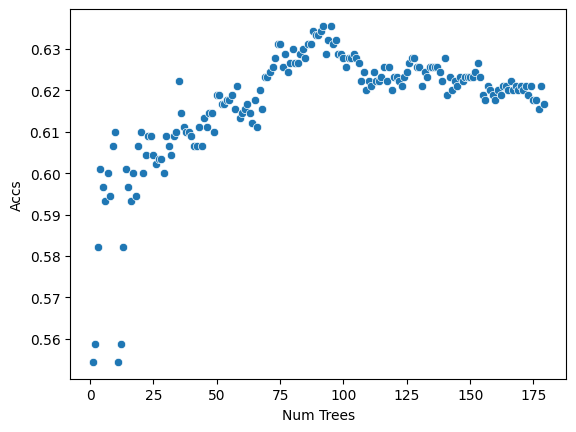

In [1005]:
distr["Num Trees"] = list(range(1,len(accs)+1))
distr["Accs"] = accs
sns.scatterplot(distr, x="Num Trees", y = "Accs")

# Testing Match-ups

In [58]:
from datetime import datetime

In [69]:
def dob_to_time(time_num):
    str_time = str(int(time_num))
    yr = str_time[:4]
    mo = str_time[4:6]
    dy = str_time[6:]
    
    format_time = "{}-{}-{}".format(dy, mo, yr)
    
    dt_time = datetime.strptime(format_time, "%d-%m-%Y")
    
    return dt_time

def dob_to_age(now, dob):
    
    if (math.isnan(dob)):
        return dob
    else:
        dt_dob = dob_to_time(dob)
        dt_now = dob_to_time(now)

        age = round((dt_now - dt_dob).days/365.25,1)

        return age

In [70]:
rankings = pd.read_csv("atp_rankings_current.csv")
rankings = rankings.rename(columns = {"player":"player_id", "rank":"Rank", "points":"Points"})
update = rankings["ranking_date"].unique()[-1]

rankings = rankings[rankings["ranking_date"]==update].reset_index(drop = True)[['Rank', 'player_id', 'Points']]

players = pd.read_csv("atp_players.csv")
players["Name"] = players["name_first"]+" "+players["name_last"]
players = players[["player_id", "Name",'hand','dob']]

rankings = pd.merge(rankings, players, on ="player_id")
rankings = rankings[["Name", "Rank", "Points","hand","dob"]]
rankings["Age"] = rankings["dob"].apply(lambda dob: dob_to_age(update, dob))
rankings["Lefty"] = rankings["hand"].apply(hand_to_num)

rankings = rankings[["Name", "Points", "Lefty", "Age", "Rank"]]

In [71]:
input_data = pd.merge(rankings, cleaned_stats, on = "Name")

In [73]:
# level_key = {"A": 0, "D": 1, "M": 2, "F":3,"G":4}

def create_match(player_a, player_b, tournament_lvl, surface):
    
    if (player_a in input_data["Name"].values and player_b in input_data["Name"].values):
    
        columns_oi = ['Lefty', 'Age', 'Rank', 'Hard S W%', 'Hard 1stIn',
           'Hard 1st%', 'Hard 2%-InP', 'Hard 2nd%', 'Hard Hld%', 'Hard v1st%',
           'Hard v2nd%', 'Hard Brk%', 'Hard BPConv%', 'Hard BPSvd%',
           'Hard Matches', 'Hard Win%', 'Clay S W%', 'Clay 1stIn', 'Clay 1st%',
           'Clay 2%-InP', 'Clay 2nd%', 'Clay Hld%', 'Clay v1st%', 'Clay v2nd%',
           'Clay Brk%', 'Clay BPConv%', 'Clay BPSvd%', 'Clay Matches', 'Clay Win%',
           'Grass S W%', 'Grass 1stIn', 'Grass 1st%', 'Grass 2%-InP', 'Grass 2nd%',
           'Grass Hld%', 'Grass v1st%', 'Grass v2nd%', 'Grass Brk%',
           'Grass BPConv%', 'Grass BPSvd%', 'Grass Matches', 'Grass Win%', 'S W%',
           '1stIn', '1st%', '2%-InP', '2nd%', 'Hld%', 'v1st%', 'v2nd%', 'Brk%',
           'BPConv%', 'BPSvd%', 'Overall Matches', 'Overall Win%']

        match = pd.DataFrame()

        match["Tournament Caliber"] = [tournament_lvl]

        match["Hard"] = [0]
        match["Clay"] = [0]
        match["Grass"] = [0]

        if surface == "C":
            match["Clay"] = [1]
        elif surface == "G":
            match["Grass"]
        else:
            match["Hard"] = [1]

        for col in columns_oi:
            player_a_val = round(input_data[input_data["Name"] == player_a][col].iloc[0],3)
            match["Player A " + col] = [player_a_val]
                        
            player_b_val = round(input_data[input_data["Name"] == player_b][col].iloc[0],3)
            match["Player B " + col] = [player_b_val]
            
        # Reordering 
        
        new_order = ['Tournament Caliber', 'Hard', 'Clay', 'Grass', 'Player A Lefty',
       'Player B Lefty', 'Player A Age', 'Player B Age', 'Player A Rank',
       'Player B Rank', 'Player A Hard S W%', 'Player B Hard S W%',
       'Player A Hard 1stIn', 'Player B Hard 1stIn', 'Player A Hard 1st%',
       'Player B Hard 1st%', 'Player A Hard 2%-InP',
       'Player B Hard 2%-InP', 'Player A Hard 2nd%', 'Player B Hard 2nd%',
       'Player A Hard Hld%', 'Player B Hard Hld%', 'Player A Hard v1st%',
       'Player B Hard v1st%', 'Player A Hard v2nd%',
       'Player B Hard v2nd%', 'Player A Hard Brk%', 'Player B Hard Brk%',
       'Player A Hard BPConv%', 'Player B Hard BPConv%',
       'Player A Hard BPSvd%', 'Player B Hard BPSvd%',
       'Player A Hard Matches', 'Player B Hard Matches',
       'Player A Hard Win%', 'Player B Hard Win%', 'Player A Clay S W%',
       'Player B Clay S W%', 'Player A Clay 1stIn', 'Player B Clay 1stIn',
       'Player A Clay 1st%', 'Player B Clay 1st%', 'Player A Clay 2%-InP',
       'Player B Clay 2%-InP', 'Player A Clay 2nd%', 'Player B Clay 2nd%',
       'Player A Clay Hld%', 'Player B Clay Hld%', 'Player A Clay v1st%',
       'Player B Clay v1st%', 'Player A Clay v2nd%',
       'Player B Clay v2nd%', 'Player A Clay Brk%', 'Player B Clay Brk%',
       'Player A Clay BPConv%', 'Player B Clay BPConv%',
       'Player A Clay BPSvd%', 'Player B Clay BPSvd%',
       'Player A Clay Matches', 'Player B Clay Matches',
       'Player A Clay Win%', 'Player B Clay Win%', 'Player A Grass S W%',
       'Player B Grass S W%', 'Player A Grass 1stIn',
       'Player B Grass 1stIn', 'Player A Grass 1st%',
       'Player B Grass 1st%', 'Player A Grass 2%-InP',
       'Player B Grass 2%-InP', 'Player A Grass 2nd%',
       'Player B Grass 2nd%', 'Player A Grass Hld%',
       'Player B Grass Hld%', 'Player A Grass v1st%',
       'Player B Grass v1st%', 'Player A Grass v2nd%',
       'Player B Grass v2nd%', 'Player A Grass Brk%',
       'Player B Grass Brk%', 'Player A Grass BPConv%',
       'Player B Grass BPConv%', 'Player A Grass BPSvd%',
       'Player B Grass BPSvd%', 'Player A Grass Matches',
       'Player B Grass Matches', 'Player A Grass Win%',
       'Player B Grass Win%', 'Player A S W%', 'Player B S W%',
       'Player A 1stIn', 'Player B 1stIn', 'Player A 1st%',
       'Player B 1st%', 'Player A 2%-InP', 'Player B 2%-InP',
       'Player A 2nd%', 'Player B 2nd%', 'Player A Hld%', 'Player B Hld%',
       'Player A v1st%', 'Player B v1st%', 'Player A v2nd%',
       'Player B v2nd%', 'Player A Brk%', 'Player B Brk%',
       'Player A BPConv%', 'Player B BPConv%', 'Player A BPSvd%',
       'Player B BPSvd%', 'Player A Overall Matches',
       'Player B Overall Matches', 'Player A Overall Win%',
       'Player B Overall Win%']
            
        return match[new_order]
    else:
        return "Input Valid Names"

In [137]:
def predict(player_a, player_b, tournament_lvl, surface):
    match = create_match(player_a, player_b, tournament_lvl, surface)
    
    if type(match) != str:
    
        # Convert to numpy array
        arr_match = np.array(match)

        # Predict
        prediction = rf.predict(arr_match)[0]

        if prediction == 1:
            return player_a
        else:
            return player_b
    else:
        return "Input valid names"

In [843]:
def bracket_predict(players, tournament_lvl, surface, start, output_bracket, mode='store'):
    if len(players) == 1:
        winner=players[0] # Final winner
        output_bracket+=[winner]

        # If storing, return the final bracket
        if mode=='store':
            return output_bracket
    else:
        winners = []
        for i in range(int(len(players)/2)):
            player_a = players[2*i]
            player_b = players[2*i + 1]            
            
            # Want to output bracket results, not store
            if mode!='store':
                rd=int(math.log2(start)) - int(math.log2(len(players)))+1
                indent = rd*"\t"
                
                rank_a=input_data[input_data["Name"] == player_a]["Rank"].iloc[0]
                rank_b=input_data[input_data["Name"] == player_b]["Rank"].iloc[0]
    
                
                print("{}-Rd.{}-".format(indent, rd))
                print("{}({}){} v. ({}){}:".format(indent, rank_a, player_a, rank_b, player_b))
            
            winner=predict(player_a, player_b, tournament_lvl, surface)
            winners.append(winner)

            #  Want to store winners from each round
            if mode=='store':
                output_bracket+=winners
            else: # Want to output the winner
                print("{}W: {}".format(indent, winner))
            
        bracket_predict(winners, tournament_lvl, surface, start, output_bracket, mode)

## Exploring Importance

In [130]:
# Finding important features

from sklearn.feature_selection import SelectFromModel


sel = SelectFromModel(RandomForestClassifier(n_estimators = 95))
sel.fit(train_features, train_labels);

In [131]:
feature_df = proc_data[['Tournament Caliber', 'Hard', 'Clay', 'Grass', 'Player A Lefty',
       'Player B Lefty', 'Player A Age', 'Player B Age', 'Player A Rank',
       'Player B Rank', 'Player A Hard S W%', 'Player B Hard S W%',
       'Player A Hard 1stIn', 'Player B Hard 1stIn', 'Player A Hard 1st%',
       'Player B Hard 1st%', 'Player A Hard 2%-InP',
       'Player B Hard 2%-InP', 'Player A Hard 2nd%', 'Player B Hard 2nd%',
       'Player A Hard Hld%', 'Player B Hard Hld%', 'Player A Hard v1st%',
       'Player B Hard v1st%', 'Player A Hard v2nd%',
       'Player B Hard v2nd%', 'Player A Hard Brk%', 'Player B Hard Brk%',
       'Player A Hard BPConv%', 'Player B Hard BPConv%',
       'Player A Hard BPSvd%', 'Player B Hard BPSvd%',
       'Player A Hard Matches', 'Player B Hard Matches',
       'Player A Hard Win%', 'Player B Hard Win%', 'Player A Clay S W%',
       'Player B Clay S W%', 'Player A Clay 1stIn', 'Player B Clay 1stIn',
       'Player A Clay 1st%', 'Player B Clay 1st%', 'Player A Clay 2%-InP',
       'Player B Clay 2%-InP', 'Player A Clay 2nd%', 'Player B Clay 2nd%',
       'Player A Clay Hld%', 'Player B Clay Hld%', 'Player A Clay v1st%',
       'Player B Clay v1st%', 'Player A Clay v2nd%',
       'Player B Clay v2nd%', 'Player A Clay Brk%', 'Player B Clay Brk%',
       'Player A Clay BPConv%', 'Player B Clay BPConv%',
       'Player A Clay BPSvd%', 'Player B Clay BPSvd%',
       'Player A Clay Matches', 'Player B Clay Matches',
       'Player A Clay Win%', 'Player B Clay Win%', 'Player A Grass S W%',
       'Player B Grass S W%', 'Player A Grass 1stIn',
       'Player B Grass 1stIn', 'Player A Grass 1st%',
       'Player B Grass 1st%', 'Player A Grass 2%-InP',
       'Player B Grass 2%-InP', 'Player A Grass 2nd%',
       'Player B Grass 2nd%', 'Player A Grass Hld%',
       'Player B Grass Hld%', 'Player A Grass v1st%',
       'Player B Grass v1st%', 'Player A Grass v2nd%',
       'Player B Grass v2nd%', 'Player A Grass Brk%',
       'Player B Grass Brk%', 'Player A Grass BPConv%',
       'Player B Grass BPConv%', 'Player A Grass BPSvd%',
       'Player B Grass BPSvd%', 'Player A Grass Matches',
       'Player B Grass Matches', 'Player A Grass Win%',
       'Player B Grass Win%', 'Player A S W%', 'Player B S W%',
       'Player A 1stIn', 'Player B 1stIn', 'Player A 1st%',
       'Player B 1st%', 'Player A 2%-InP', 'Player B 2%-InP',
       'Player A 2nd%', 'Player B 2nd%', 'Player A Hld%', 'Player B Hld%',
       'Player A v1st%', 'Player B v1st%', 'Player A v2nd%',
       'Player B v2nd%', 'Player A Brk%', 'Player B Brk%',
       'Player A BPConv%', 'Player B BPConv%', 'Player A BPSvd%',
       'Player B BPSvd%', 'Player A Overall Matches',
       'Player B Overall Matches', 'Player A Overall Win%',
       'Player B Overall Win%']]

In [132]:
selected_feat= feature_df.columns[(sel.get_support())]
print(selected_feat)

Index(['Tournament Caliber', 'Player A Age', 'Player B Age', 'Player A Rank',
       'Player B Rank', 'Player A Hard S W%', 'Player B Hard S W%',
       'Player B Hard 2nd%', 'Player B Hard Hld%', 'Player A Hard v2nd%',
       'Player A Hard Brk%', 'Player A Hard Matches', 'Player A Hard Win%',
       'Player B Hard Win%', 'Player A Clay S W%', 'Player B Clay S W%',
       'Player A Clay Win%', 'Player B Clay Win%', 'Player B Grass S W%',
       'Player B Grass Hld%', 'Player A Grass v2nd%', 'Player A S W%',
       'Player B S W%', 'Player B 2nd%', 'Player A Hld%', 'Player B Hld%',
       'Player A Overall Matches', 'Player B Overall Matches',
       'Player A Overall Win%', 'Player B Overall Win%'],
      dtype='object')


In [124]:
sample_x = np.array(create_match("Novak Djokovic", "Stefanos Tsitsipas", 4, "H"))

In [133]:
imp_df = pd.DataFrame(columns = ["Feat", "Imp"])
imp_df["Feat"] = feature_df.columns
imp_df["Imp"] = sel.estimator_.feature_importances_

In [136]:
imp_df.sort_values(by = "Imp", ascending = False).head(50)

,Feat,Imp
8,Player A Rank,0.033009
9,Player B Rank,0.027919
7,Player B Age,0.023755
6,Player A Age,0.022885
113,Player B Overall Win%,0.019852
112,Player A Overall Win%,0.018505
89,Player B S W%,0.017898
34,Player A Hard Win%,0.016947
88,Player A S W%,0.014914
35,Player B Hard Win%,0.013833
